In [8]:
import imageio.v2 as imageio
import imgaug as ia
import imgaug.augmenters as iaa
from imgaug import parameters as iap
import glob
import numpy as np
import cv2
import os


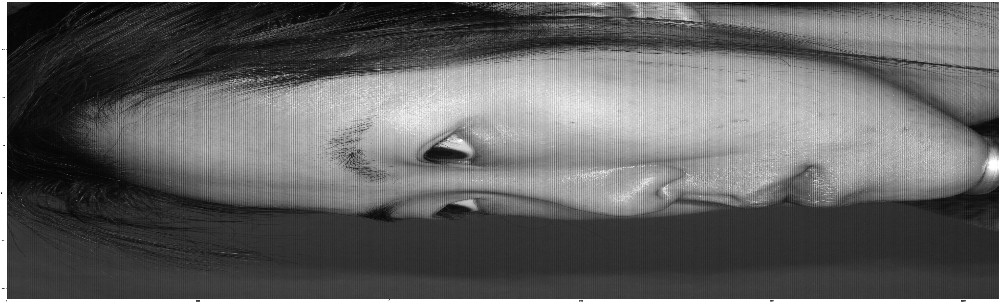

(3456, 3112, 3)


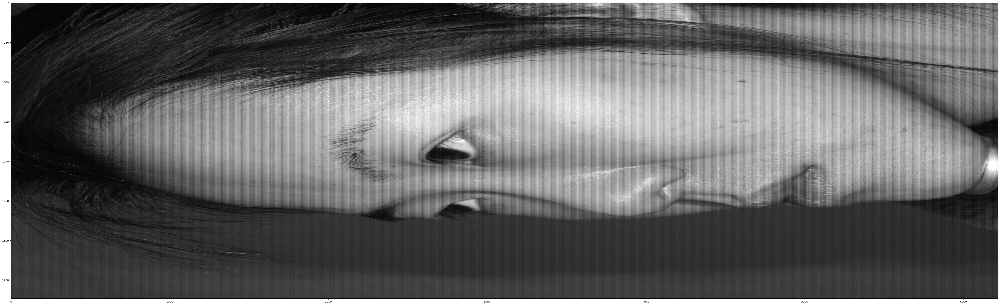

(2073, 1867, 3)


In [6]:
#import images
path = glob.glob("D:\DemoAugmentation\demo\*.jpg")
cv_img = []

for img in path:
    n = cv2.imread(img)
    width, height,_ = n.shape
    if width == 3456 and height == 3112:
        #r_n = n.resize(1728,1556,3)
        cv_img.append(n)
 
ia.imshow(np.hstack(cv_img)) 
#cv_img = cv_img*10
#img = imageio.imread() 

In [14]:
print(len(cv_img))
print(type(cv_img))
print(np.shape(cv_img))

2
<class 'list'>
(2, 3456, 3112, 3)


In [28]:
#Sequential for Augemntation
ia.seed(1)

seq = iaa.Sequential([
    #crop imge
    #iaa.Resize((0.7,1.0)),

    #Geometry transformation
    iaa.Affine(rotate=(-55, 55)),
    #iaa.Crop(percent=(0, 0.2)), 
    iaa.Fliplr(0.2), #horizontally
    iaa.Flipud(0.2), #vertically

     
    #Color Space transformation
    iaa.AddToBrightness((-70, 70)),
    iaa.RemoveSaturation(0.2),
    iaa.AddToSaturation((-30, 30)),

    #Filter transformation
    iaa.AdditiveGaussianNoise(scale=(0, 30),per_channel=False), #Noise
    iaa.AdditiveGaussianNoise(scale=(0, 30),per_channel=True), #Color Noise
    iaa.GaussianBlur(sigma=(0,3.0)) 
])


In [ ]:
#Augmentation Images  
images_aug = seq(images=cv_img)
print("Augmented:")
ia.imshow(np.hstack(images_aug))

In [29]:
#import images
path = glob.glob("D:\DemoAugmentation\_acne04_relabel\*.jpg")
path_save = "D:\DemoAugmentation\demo2"
j = 0
others_img = 0
SCALE = 30 # percent of original size

for img in path:
    ip_img = []

    n = cv2.imread(img)
    width, height,_ = n.shape
    
    # Only get image with same dimensions
    if width == 3456 and height == 3112:
        RGB_img = cv2.cvtColor(n, cv2.COLOR_BGR2RGB)
        print(RGB_img.shape)

        print("Resized to: ")
        w = int(RGB_img.shape[1] * SCALE / 100)
        h = int(RGB_img.shape[0] * SCALE / 100)
        dim = (w, h)
        RGB_img = cv2.resize(RGB_img, dim, interpolation = cv2.INTER_AREA)
        print(RGB_img.shape)

        ip_img.append(RGB_img)
        augmented = seq(images=ip_img)

        for i,augment in enumerate(augmented):
            cv2.imwrite("D:\DemoAugmentation\demo2\%i.jpg" % (j,), cv2.cvtColor(augment, cv2.COLOR_RGB2BGR))
            j+=1    
        print("Image saved")
        print("---------------------------------------------------------------")
    else:
        others_img += 1     
print("Doneeee")
print("other images: %i", others_img)


(3456, 3112, 3)
Resized to: 
(1036, 933, 3)
Image saved
---------------------------------------------------------------
(3456, 3112, 3)
Resized to: 
(1036, 933, 3)
Image saved
---------------------------------------------------------------
(3456, 3112, 3)
Resized to: 
(1036, 933, 3)
Image saved
---------------------------------------------------------------
(3456, 3112, 3)
Resized to: 
(1036, 933, 3)
Image saved
---------------------------------------------------------------
(3456, 3112, 3)
Resized to: 
(1036, 933, 3)
Image saved
---------------------------------------------------------------
(3456, 3112, 3)
Resized to: 
(1036, 933, 3)
Image saved
---------------------------------------------------------------
(3456, 3112, 3)
Resized to: 
(1036, 933, 3)
Image saved
---------------------------------------------------------------
(3456, 3112, 3)
Resized to: 
(1036, 933, 3)
Image saved
---------------------------------------------------------------
(3456, 3112, 3)
Resized to: 
(1036, 933,